In [1]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)
%cd /content/gdrive/MyDrive/Colab\ Notebooks/cs250/

Mounted at /content/gdrive
/content/gdrive/MyDrive/Colab Notebooks/cs250


In [2]:
import numpy as np
import os
import math
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
from torch.utils.data import sampler
import torchvision
import torchvision.transforms as T

import matplotlib.pyplot as plt
from utils import GANDataset

In [ ]:
day_train = GANDataset('./night2day_128', day=True, train=True, transform=None)
loader_dtrain = DataLoader(day_train, batch_size=16, shuffle=True)

night_train = GANDataset('./night2day_128', day=False, train=True, transform=None)
loader_ntrain = DataLoader(night_train, batch_size=16, shuffle=True)

day_test = GANDataset('./night2day_128', day=True, train=False, transform=None)
loader_dtest = DataLoader(day_test, batch_size=16, shuffle=False)

night_test = GANDataset('./night2day_128', day=False, train=False, transform=None)
loader_ntest = DataLoader(night_test, batch_size=16, shuffle=False)

In [ ]:

figure = plt.figure(figsize=(8, 4))
cols, rows = 4, 2

for i in range(rows * cols):
    sample_idx = torch.randint(len(day_train), size=(1,)).item()
    img = day_train[sample_idx]
    figure.add_subplot(rows, cols, i+1)
    plt.axis("off")
    plt.imshow(img.permute(1, 2, 0))

plt.show()

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
print(device)

In [ ]:
class genNet(nn.Module): # 3x128x128 => goes to same shape; using UNet architecture
    def __init__(self):
        super(genNet, self).__init__()

        self.conv1 = nn.Conv2d(3, 64, 3)
        self.conv2 = nn.Conv2d(64, 64, 3)
        self.conv3 = nn.Conv2d(64, 128, 3)
        self.conv4 = nn.Conv2d(128, 128, 3)
        self.conv5 = nn.Conv2d(128, 256, 3)
        self.conv6 = nn.Conv2d(256, 256, 3)
        self.conv15 = nn.Conv2d(256, 512, 3)


        self.pool = nn.MaxPool2d(2, 2)
        self.pad1 = nn.ReflectionPad2d(2)
        self.pad2 = nn.ZeroPad2d(1)
        self.pad3 = nn.ReflectionPad2d(1)

        self.uconv1 = nn.ConvTranspose2d(512, 256, 2, stride=2)
        self.uconv2 = nn.ConvTranspose2d(256, 128, 2, stride=2)
        self.uconv3 = nn.ConvTranspose2d(128, 64, 2, stride=2)

        self.conv7 = nn.Conv2d(512, 256, 3)
        self.conv8 = nn.Conv2d(256, 128, 3)
        self.conv9 = nn.Conv2d(128, 64, 1)
        self.conv14 = nn.Conv2d(64, 3, 1)

        # ResNet
        self.conv10 = nn.Conv2d(256, 64, 1)
        self.conv11 = nn.Conv2d(64, 256, 1)
        self.conv12 = nn.Conv2d(512, 64, 1)
        self.conv13 = nn.Conv2d(64, 512, 1)


    def forward(self, x):
        x = F.leaky_relu(self.conv1(x))
        x = self.pad1(F.leaky_relu(self.conv2(x)))
        x32 = x.clone() # 256 x 256

        x = self.pool(x) # 128
        x = F.leaky_relu(self.conv3(x))
        x = self.pad1(F.leaky_relu(self.conv4(x)))
        x64 = x.clone() # 128

        x = self.pool(x) # 64
        x = F.leaky_relu(self.conv5(x))
        x = self.pad1(F.leaky_relu(self.conv6(x))) # 64
        x128 = x.clone()

        x = self.pool(x) # 32
        x = F.leaky_relu(self.conv15(x)) # 26x256x256

        y = F.leaky_relu(self.conv12(x))
        y = F.leaky_relu(self.conv2(y))
        y = F.leaky_relu(self.conv13(y))
        x = torch.add(x, self.pad2(y)) # 256 x 24 x 24

        x = self.pad3(x) # 32x32


        x = self.uconv1(x)
        x = torch.cat((x128, x), 1) # 256 x 64 x 64
        x = F.leaky_relu(self.conv7(x))
        x = self.pad1(F.leaky_relu(self.conv6(x)))


        x = self.uconv2(x)
        x = torch.cat((x64, x), 1) # 128 x 128 x 128
        x = F.leaky_relu(self.conv8(x))
        x = self.pad1(F.leaky_relu(self.conv4(x)))


        x = self.uconv3(x)
        x = torch.cat((x32, x), 1) # 256 x 64 x 64
        x = F.leaky_relu(self.conv9(x))
        x = self.conv14(x)

        return torch.tanh(x)

class disNet(nn.Module): # reducing to single value; using ResNET and linear reduction
    def __init__(self):
        super(disNet, self).__init__()
        self.conv1 = nn.Conv2d(3, 32, 5)
        self.conv2 = nn.Conv2d(16, 16, 3)
        self.conv3 = nn.Conv2d(16, 32, 5)
        self.conv4 = nn.Conv2d(32, 32, 3)
        self.conv5 = nn.Conv2d(32, 64, 3)
        self.conv6 = nn.Conv2d(64, 64, 3)
        self.conv7 = nn.Conv2d(64, 128, 3)
        self.conv8 = nn.Conv2d(128, 128, 3)
        self.conv9 = nn.Conv2d(128, 256, 3)
        self.conv10 = nn.Conv2d(256, 256, 3)


        self.pool = nn.MaxPool2d(2, 2)
        self.fc4 = nn.Linear(6400, 2048)
        self.fc1 = nn.Linear(2048, 968)
        self.fc2 = nn.Linear(968, 84)
        self.fc3 = nn.Linear(84, 1)

        self.conv11 = nn.Conv2d(128, 32, 1)
        self.conv12 = nn.Conv2d(32, 128, 1)
        self.conv13 = nn.Conv2d(256, 64, 1)
        self.conv14 = nn.Conv2d(64, 256, 1)
        self.pad1 = nn.ZeroPad2d(1)

    def forward(self, x):
        x = F.leaky_relu(self.conv1(x))
        x = self.pool(F.leaky_relu(self.conv4(x)))

        x = F.leaky_relu(self.conv5(x))
        x = self.pool(F.leaky_relu(self.conv6(x)))

        x = F.leaky_relu(self.conv7(x))
        x = self.pool(F.leaky_relu(self.conv8(x)))

        x = F.leaky_relu(self.conv9(x))
        # x = self.pool(F.relu(self.conv8(x)))
        y = F.leaky_relu(self.conv13(x))
        y = F.leaky_relu(self.conv6(y))
        y = F.leaky_relu(self.conv14(y))
        x = torch.add(x, self.pad1(y))
        x = self.pool(x)

        x = torch.flatten(x, 1) # flatten all dimensions except batch
        x = F.leaky_relu(self.fc4(x))
        x = F.leaky_relu(self.fc1(x))
        x = F.leaky_relu(self.fc2(x))
        x = self.fc3(x)
        return x

In [ ]:
def train(loader_dtrain, loader_ntrain, loader_dtest, loader_ntest, models, optimizers, schedulers, epochs=100):
    lam = 12 # lambda parameter
    cycle_criterion = nn.L1Loss()
    convert_criterion = nn.MSELoss()

    for model in models:
      model = model.cuda()
      pass

    mean_Y = []; mean_X = []

    for e in range(epochs):
        running_loss = 0.0
        for model in models:
          model.train()

        [model_GXY, model_GYX, model_DY, model_DX] = models
        [optimizer_GXY, optimizer_GYX, optimizer_DY, optimizer_DX] = optimizers

        curr_index = 0
        # idea is that datasets can be different sizes
        # so have two different iters, and only update the smaller every couple iterations of the larger
        # this means smaller dataset will be reused a bit
        reload = False
        while not reload:
            try:
                ntrain_iter = iter(loader_ntrain)
                y = next(ntrain_iter)
                reload = True
            except: # seems to be some sort of threading issue here? this is a failsafe for that
                print("loader_ntrain failed to reset. Reloading...")

        outputs_Y_total = []
        outputs_X_total = []

        for t, x in enumerate(loader_dtrain): # merge apple -> orange & orange -> apple
            if int(t * len(loader_ntrain) / len(loader_dtrain)) > curr_index:
              curr_index += 1

              try:
                y = next(ntrain_iter)
              except:
                pass # just keep y as before

            inputs_X = x.to(device); inputs_Y = y.to(device)

            outputs_Y = model_GXY(inputs_X)
            ninputs_X = model_GYX(outputs_Y)
            outputs_X = model_GYX(inputs_Y)
            ninputs_Y = model_GXY(outputs_X)

            fake_Y = model_DY(outputs_Y)
            fake_X = model_DX(outputs_X)
            real_Y = model_DY(inputs_Y)
            real_X = model_DX(inputs_X)

            # push Dy(G(x)) -> 1, F(G(x)) -> x; for 2nd, Dx(G(y)) -> 1, G(F(y)) -> y
            loss_GXY = convert_criterion(fake_Y, torch.zeros(fake_Y.shape).float().to(device)+1) + lam * cycle_criterion(ninputs_X, inputs_X)
            optimizer_GXY.zero_grad()
            loss_GXY.backward(retain_graph=True)

            loss_GYX = convert_criterion(fake_X, torch.zeros(fake_X.shape).float().to(device)+1) + lam * cycle_criterion(ninputs_Y, inputs_Y)
            optimizer_GYX.zero_grad()
            loss_GYX.backward(retain_graph=True)

            # push Dy(y) -> 1 (or close), Dy(G(x)) -> 0; for 2nd, Dx(x) -> 1, Dx(G(y)) -> 0
            loss_DY = convert_criterion(real_Y, torch.zeros(real_Y.shape).float().to(device)+0.9) + convert_criterion(fake_Y, torch.zeros(fake_Y.shape).float().to(device))
            optimizer_DY.zero_grad()
            loss_DY.backward(retain_graph=True)

            loss_DX = convert_criterion(real_X, torch.zeros(real_X.shape).float().to(device)+0.9) + convert_criterion(fake_X, torch.zeros(fake_X.shape).float().to(device))
            optimizer_DX.zero_grad()
            loss_DX.backward()

            optimizer_GXY.step()
            optimizer_GYX.step()
            optimizer_DY.step()
            optimizer_DX.step()

            outputs_Y_total += list(model_DY(outputs_Y).flatten())
            outputs_X_total += list(model_DX(outputs_X).flatten())

            # print statistics
            total_loss = loss_GXY.item() + loss_GYX.item() + loss_DY.item() + loss_DX.item()
            running_loss += total_loss
            if t % 75 == 0:
                print('Epoch %d, Iteration %d, loss = %.4f' % (e, t, total_loss))
            if t == 300:
                print("Progress Report: hopefully close to 1:", model_DY(outputs_Y).flatten(), model_DX(outputs_X).flatten())

        for scheduler in schedulers:
          if e >= 15:
            scheduler.step()

        #print("Progress Report: hopefully close to 1:", model_DY(outputs_Y), model_DX(outputs_X))
        test(loader_dtest, loader_ntest, [model_GXY, model_GYX])


        mean_Y.append(np.mean(outputs_Y_total))
        mean_X.append(np.mean(outputs_X_total))

In [ ]:
def test(loader_dtest, loader_ntest, models):

    for model in models:
        model.eval() # set model to evaluation mode
    [model_GXY, model_GYX] = models
    with torch.no_grad():

        figure = plt.figure(figsize=(8, 4))
        cols, rows = 4, 2

        im_list = []

        dtest_iter = iter(loader_dtest)
        for i in range(torch.randint(low=1, high=7, size=(1,)).item()):
            ims_X = next(dtest_iter)
        ims_X = ims_X.to(device)
        outs_Y = model_GXY(ims_X)

        ntest_iter = iter(loader_ntest)
        for i in range(torch.randint(low=1, high=7, size=(1,)).item()):
            ims_Y = next(ntest_iter)
        ims_Y = ims_Y.to(device)
        outs_X = model_GYX(ims_Y)

        num1 = torch.randint(low=0, high=8, size=(1,)).item()
        num2 = 0
        while num2 == num1:
          num2 = torch.randint(low=0, high=8, size=(1,)).item()

        im_list = [ims_X[num1], outs_Y[num1], ims_X[num2], outs_Y[num2], ims_Y[num1], outs_X[num1], ims_Y[num2], outs_X[num2]]


        for i in range(rows * cols):
            img = im_list[i]
            figure.add_subplot(rows, cols, i+1)
            plt.axis("off")
            plt.imshow(img.cpu().permute(1, 2, 0))


    torch.save(model_GXY.state_dict(), "./GAN_GXY")
    torch.save(model_GYX.state_dict(), "./GAN_GYX")

    plt.show()


In [ ]:
# DO NOT RUN UNLESS RETRAINING
# NOTE: training is inconsistent – might have to run a few times to get convergent models
# My submitted .ipynb contains an example of convergent training, and I have submitted the resultant models as well
# These are the models GAN_GXY_saved and GAN_GYX_saved that are used for visualization below
genXY = genNet()
genYX = genNet()
disY = disNet()
disX = disNet()

optimizer_GXY = optim.Adam(genXY.parameters(), lr=0.00008/0.9, betas=(0.9, 0.999))
optimizer_GYX = optim.Adam(genYX.parameters(), lr=0.00008/0.9, betas=(0.9, 0.999))
# tweaking discriminator rates down helps generator catch up
optimizer_DY = optim.Adam(disY.parameters(), lr=0.00004/0.8, betas=(0.9, 0.999))
optimizer_DX = optim.Adam(disX.parameters(), lr=0.00004/0.8, betas=(0.9, 0.999))

scheduler_GXY = optim.lr_scheduler.LinearLR(optimizer_GXY, start_factor=1, end_factor=0, total_iters=15)
scheduler_GYX = optim.lr_scheduler.LinearLR(optimizer_GXY, start_factor=1, end_factor=0, total_iters=15)
scheduler_DY = optim.lr_scheduler.LinearLR(optimizer_GXY, start_factor=1, end_factor=0, total_iters=15)
scheduler_DX = optim.lr_scheduler.LinearLR(optimizer_GXY, start_factor=1, end_factor=0, total_iters=15)

models = [genXY, genYX, disY, disX]
optimizers = [optimizer_GXY, optimizer_GYX, optimizer_DY, optimizer_DX]
schedulers = [scheduler_GXY, scheduler_GYX, scheduler_DY, scheduler_DX]
train(loader_dtrain, loader_ntrain, loader_dtest, loader_ntest, models, optimizers, schedulers, epochs=100)

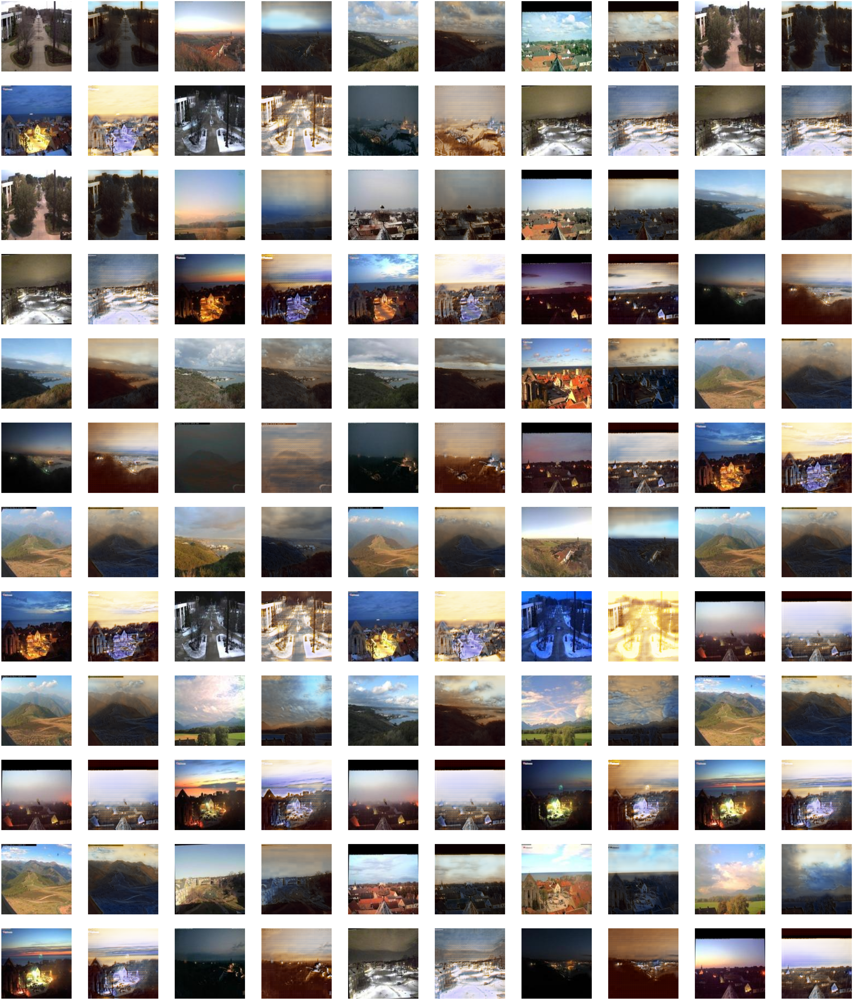

In [ ]:
# this code uses the models trained above; i manually renamed them to "..._saved"
# note that retraining (to another epoch) will produce another ./GAN_GXY and ./GAN_GYX
model_GXY = genNet()
model_GYX = genNet()
model_GXY.load_state_dict(torch.load("./GAN_GXY_saved"))
model_GYX.load_state_dict(torch.load("./GAN_GYX_saved"))
model_GXY.eval()
model_GYX.eval()

figure = plt.figure(figsize=(80, 96))
cols, rows = 10, 12

day_indices = torch.randint(len(day_test)-1, size=(30,))
night_indices = torch.randint(len(night_test)-1, size=(30,))

for i in range(6):
  for j in range(10):
    if j < 5:
      img = day_test[day_indices[4*i + j].item()]
      conv_img = model_GXY(img.reshape(1,3,128,128))[0].detach()

      figure.add_subplot(rows, cols, 20*i + 2*j + 1)
      plt.axis("off")
      plt.imshow(img.permute(1,2,0))
      figure.add_subplot(rows, cols, 20*i + 2*j + 2)
      plt.axis("off")
      plt.imshow(conv_img.permute(1,2,0))

    else:
      img = night_test[night_indices[4*i + j-5].item()]
      conv_img = model_GYX(img.reshape(1,3,128,128))[0].detach()

      figure.add_subplot(rows, cols, 20*i + 2*j + 1)
      plt.axis("off")
      plt.imshow(img.permute(1,2,0))
      figure.add_subplot(rows, cols, 20*i + 2*j + 2)
      plt.axis("off")
      plt.imshow(conv_img.permute(1,2,0))


plt.savefig("output.jpg")
plt.show()